# **Final Capstone Project**

In [1]:
#import needed libraries

import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON fil
import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes
import folium # map rendering library

#from geopy.geocoders import Nominatim # convert an address into latitude and longitude values
from geopy.geocoders import Nominatim

!pip install geocoder
import geocoder

print('Libraries imported.')

     |████████████████████████████████| 98 kB 1.7 MB/s eta 0:00:011
Libraries imported.


In [2]:
#load information about NYC neighborhoods and boroughs
with open('../input/nyc-data/newyork_data.json') as json_data:
    newyork_data = json.load(json_data)

In [3]:
newyork_data

{'type': 'FeatureCollection',
 'totalFeatures': 306,
 'features': [{'type': 'Feature',
   'id': 'nyu_2451_34572.1',
   'geometry': {'type': 'Point',
    'coordinates': [-73.84720052054902, 40.89470517661]},
   'geometry_name': 'geom',
   'properties': {'name': 'Wakefield',
    'stacked': 1,
    'annoline1': 'Wakefield',
    'annoline2': None,
    'annoline3': None,
    'annoangle': 0.0,
    'borough': 'Bronx',
    'bbox': [-73.84720052054902,
     40.89470517661,
     -73.84720052054902,
     40.89470517661]}},
  {'type': 'Feature',
   'id': 'nyu_2451_34572.2',
   'geometry': {'type': 'Point',
    'coordinates': [-73.82993910812398, 40.87429419303012]},
   'geometry_name': 'geom',
   'properties': {'name': 'Co-op City',
    'stacked': 2,
    'annoline1': 'Co-op',
    'annoline2': 'City',
    'annoline3': None,
    'annoangle': 0.0,
    'borough': 'Bronx',
    'bbox': [-73.82993910812398,
     40.87429419303012,
     -73.82993910812398,
     40.87429419303012]}},
  {'type': 'Feature',
 

In [4]:
#All the relevant data is in the features key, which is basically a list of the neighborhoods. So, let's define a new variable that includes this data.
neighborhoods_data = newyork_data['features']

In [5]:
neighborhoods_data[0]

{'type': 'Feature',
 'id': 'nyu_2451_34572.1',
 'geometry': {'type': 'Point',
  'coordinates': [-73.84720052054902, 40.89470517661]},
 'geometry_name': 'geom',
 'properties': {'name': 'Wakefield',
  'stacked': 1,
  'annoline1': 'Wakefield',
  'annoline2': None,
  'annoline3': None,
  'annoangle': 0.0,
  'borough': 'Bronx',
  'bbox': [-73.84720052054902,
   40.89470517661,
   -73.84720052054902,
   40.89470517661]}}

In [6]:
#Transform the data into a pandas dataframe

# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
neighborhoods = pd.DataFrame(columns=column_names)

In [7]:
#Then let's loop through the data and fill the dataframe one row at a time.

for data in neighborhoods_data:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    neighborhoods = neighborhoods.append({'Borough': borough,''
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)

In [8]:
neighborhoods.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


In [9]:
#Let's check that the dataset includes the expected 5 boroughs and 306 neighborhoods.
print('The dataframe has {} boroughs and {} neighborhoods.'.format(
        len(neighborhoods['Borough'].unique()),
        neighborhoods.shape[0]
    )
)

The dataframe has 5 boroughs and 306 neighborhoods.


In [25]:
#What are the 5 boroughs of NYC?
df_borough = neighborhoods['Borough'].unique()
df_borough


array(['Bronx', 'Manhattan', 'Brooklyn', 'Queens', 'Staten Island'],
      dtype=object)

In [26]:
#Let's slice the data to Manhattan only 
manhattan_data = neighborhoods[neighborhoods['Borough'] == 'Manhattan'].reset_index(drop=True)
manhattan_data.head()


,Borough,Neighborhood,Latitude,Longitude
0,Manhattan,Marble Hill,40.876551,-73.910660
1,Manhattan,Chinatown,40.715618,-73.994279
2,Manhattan,Washington Heights,40.851903,-73.936900
3,Manhattan,Inwood,40.867684,-73.921210
4,Manhattan,Hamilton Heights,40.823604,-73.949688


In [27]:
#Let's get the geographical coordinates of Manhattan.

address = 'Manhattan, NY'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Manhattan are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Manhattan are 40.7896239, -73.9598939.


In [28]:
#Let's visualize the neighborhoods of Manhattan to get and overview.

# create map of Manhattan using latitude and longitude values
map_manhattan = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map for each Neighbourhood
for lat, lng, label in zip(manhattan_data['Latitude'], manhattan_data['Longitude'], manhattan_data['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_manhattan)  
    
map_manhattan

In [29]:
#load AirBNB data for NYC 2019
airbnb_data = pd.read_csv('../input/new-york-city-airbnb-open-data/AB_NYC_2019.csv')

In [30]:
airbnb_data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [31]:
#Focus on Manhattan data
manhattan_airbnb_data = airbnb_data[airbnb_data['neighbourhood_group'] == 'Manhattan'].reset_index(drop=True)
manhattan_airbnb_data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
1,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
2,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
3,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,2019-06-22,0.59,1,129
4,5178,Large Furnished Room Near B'way,8967,Shunichi,Manhattan,Hell's Kitchen,40.76489,-73.98493,Private room,79,2,430,2019-06-24,3.47,1,220


In [34]:
#size of the data
manhattan_airbnb_data.shape

(21661, 16)

In [33]:
#count missing data in each column
for column in missing_data.columns.values.tolist():
    print(column)
    print (missing_data[column].value_counts())
    print("")    

id
False    21661
Name: id, dtype: int64

name
False    21652
True         9
Name: name, dtype: int64

host_id
False    21661
Name: host_id, dtype: int64

host_name
False    21652
True         9
Name: host_name, dtype: int64

neighbourhood_group
False    21661
Name: neighbourhood_group, dtype: int64

neighbourhood
False    21661
Name: neighbourhood, dtype: int64

latitude
False    21661
Name: latitude, dtype: int64

longitude
False    21661
Name: longitude, dtype: int64

room_type
False    21661
Name: room_type, dtype: int64

price
False    21661
Name: price, dtype: int64

minimum_nights
False    21661
Name: minimum_nights, dtype: int64

number_of_reviews
False    21661
Name: number_of_reviews, dtype: int64

last_review
False    16632
True      5029
Name: last_review, dtype: int64

reviews_per_month
False    16632
True      5029
Name: reviews_per_month, dtype: int64

calculated_host_listings_count
False    21661
Name: calculated_host_listings_count, dtype: int64

availability_365
False

In [35]:
#check data types
manhattan_airbnb_data.dtypes

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object

In [36]:
#get some information about the data
manhattan_airbnb_data.describe(include = "all")

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
count,2.166100e+04,21652,2.166100e+04,21652,21661,21661,21661.000000,21661.000000,21661,21661.000000,21661.000000,21661.000000,16632,16632.000000,21661.000000,21661.000000
unique,NaN,21264,NaN,5972,1,32,NaN,NaN,3,NaN,NaN,NaN,1565,NaN,NaN,NaN
top,NaN,Harlem Gem,NaN,Sonder (NYC),Manhattan,Harlem,NaN,NaN,Entire home/apt,NaN,NaN,NaN,2019-06-23,NaN,NaN,NaN
freq,NaN,7,NaN,327,21661,2658,NaN,NaN,13199,NaN,NaN,NaN,599,NaN,NaN,NaN
mean,1.877494e+07,NaN,6.783062e+07,NaN,NaN,NaN,40.765062,-73.974607,NaN,196.875814,8.579151,20.985596,NaN,1.272131,12.791330,111.979410
std,1.116793e+07,NaN,7.936435e+07,NaN,NaN,NaN,0.038463,0.022138,NaN,291.383183,24.050857,42.572277,NaN,1.628252,48.234766,132.677836
min,2.595000e+03,NaN,2.845000e+03,NaN,NaN,NaN,40.702340,-74.018510,NaN,0.000000,1.000000,0.000000,NaN,0.010000,1.000000,0.000000
25%,9.162161e+06,NaN,8.525424e+06,NaN,NaN,NaN,40.731820,-73.991690,NaN,95.000000,1.000000,1.000000,NaN,0.170000,1.000000,0.000000
50%,1.911684e+07,NaN,3.065628e+07,NaN,NaN,NaN,40.760880,-73.980420,NaN,150.000000,3.000000,4.000000,NaN,0.610000,1.000000,36.000000
75%,2.954121e+07,NaN,1.069498e+08,NaN,NaN,NaN,40.795090,-73.953840,NaN,220.000000,6.000000,19.000000,NaN,1.890000,2.000000,230.000000


In [37]:
# create map of Manhattan Airbnb accomodation 
map_manhattan_airbnb = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, label in zip(manhattan_airbnb_data['latitude'], manhattan_airbnb_data['longitude'], manhattan_airbnb_data['neighbourhood_group']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='red',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_manhattan_airbnb)  
    
map_manhattan_airbnb

let's analyse the structure of the prices

In [38]:
manhattan_airbnb_data['price'].min()

0

In [39]:
manhattan_airbnb_data['price'].max()

10000

In [40]:
manhattan_airbnb_data['price'].mean()

196.8758136743456

In [42]:
#which accommodation has a price = 0
price_0 = manhattan_airbnb_data[manhattan_airbnb_data['price']==0].reset_index(drop=True)
price_0


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,20933849,the best you can find,13709292,Qiuchi,Manhattan,Murray Hill,40.75091,-73.97597,Entire home/apt,0,3,0,NaN,NaN,1,0


In [43]:
#let's calculate the mean values when grouping per neighborhood
neighbourhood_mean = manhattan_airbnb_data.groupby(['neighbourhood']).mean()

In [44]:
#how many neighborhoods to we have in Manhattan
neighbourhood_mean.shape

(32, 10)

In [45]:
neighbourhood_mean

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
neighbourhood,,,,,,,,,,
Battery Park City,1.831094e+07,6.765555e+07,40.709964,-74.016585,367.557143,30.328571,8.285714,0.675556,9.442857,100.328571
Chelsea,1.888020e+07,6.504733e+07,40.744687,-73.998110,249.738544,10.026056,21.240791,1.254698,16.260557,113.995508
Chinatown,1.802833e+07,5.627278e+07,40.715620,-73.993907,161.497283,5.673913,27.013587,1.369190,1.497283,90.796196
Civic Center,1.901076e+07,5.311771e+07,40.713855,-74.003628,191.942308,7.500000,12.250000,0.775667,2.500000,68.269231
East Harlem,1.888549e+07,6.868314e+07,40.796143,-73.942285,133.198747,5.857654,32.628469,1.672733,2.386750,98.973142
East Village,1.666149e+07,4.932739e+07,40.726763,-73.983857,186.083108,6.467350,24.106854,1.119732,3.628710,74.623853
Financial District,2.513816e+07,1.135816e+08,40.706906,-74.009167,225.490591,12.248656,9.315860,1.477485,114.857527,191.536290
Flatiron District,1.730495e+07,5.999391e+07,40.741052,-73.988413,341.925000,6.225000,17.737500,1.251207,7.387500,123.050000
Gramercy,1.632258e+07,4.956351e+07,40.735572,-73.984298,222.754438,8.547337,22.727811,1.120837,5.772189,94.526627


In [46]:
#let's focus on price, reviews per month and availability to find the right accommodation
manhattan_overview = neighbourhood_mean[['price','reviews_per_month','availability_365']]
manhattan_overview

,price,reviews_per_month,availability_365
neighbourhood,,,
Battery Park City,367.557143,0.675556,100.328571
Chelsea,249.738544,1.254698,113.995508
Chinatown,161.497283,1.369190,90.796196
Civic Center,191.942308,0.775667,68.269231
East Harlem,133.198747,1.672733,98.973142
East Village,186.083108,1.119732,74.623853
Financial District,225.490591,1.477485,191.536290
Flatiron District,341.925000,1.251207,123.050000
Gramercy,222.754438,1.120837,94.526627


(array([2.0756e+04, 6.9200e+02, 9.5000e+01, 4.0000e+01, 2.2000e+01,
        1.8000e+01, 9.0000e+00, 8.0000e+00, 4.0000e+00, 0.0000e+00,
        4.0000e+00, 0.0000e+00, 3.0000e+00, 3.0000e+00, 0.0000e+00,
        2.0000e+00, 0.0000e+00, 1.0000e+00, 0.0000e+00, 4.0000e+00]),
 array([    0.,   500.,  1000.,  1500.,  2000.,  2500.,  3000.,  3500.,
         4000.,  4500.,  5000.,  5500.,  6000.,  6500.,  7000.,  7500.,
         8000.,  8500.,  9000.,  9500., 10000.]),
 <a list of 20 Patch objects>)

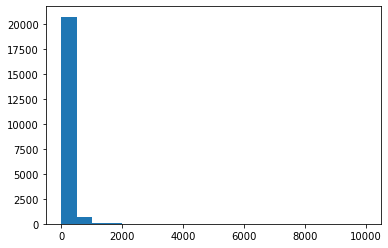

In [47]:
# Distribution of the prices
%matplotlib inline
import matplotlib as plt
from matplotlib import pyplot
plt.pyplot.hist(manhattan_airbnb_data["price"], bins=20)

In [48]:
#limit the data to only prices below 500, because above there are only a few luxury accomodations
price_df=manhattan_airbnb_data[manhattan_airbnb_data['price']<500]

(array([  22.,  700., 2238., 3076., 2622., 2102., 2183., 1962., 1418.,
         947.,  950.,  606.,  552.,  226.,  351.,  254.,  210.,   82.,
         133.,  122.]),
 array([  0.  ,  24.95,  49.9 ,  74.85,  99.8 , 124.75, 149.7 , 174.65,
        199.6 , 224.55, 249.5 , 274.45, 299.4 , 324.35, 349.3 , 374.25,
        399.2 , 424.15, 449.1 , 474.05, 499.  ]),
 <a list of 20 Patch objects>)

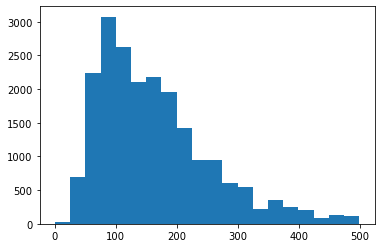

In [49]:
# Binning
%matplotlib inline
import matplotlib as plt
from matplotlib import pyplot
plt.pyplot.hist(price_df["price"], bins=20)

In [50]:
#Define Foursquare Credentials and Version

CLIENT_ID = 'xxxxxx' # your Foursquare ID
CLIENT_SECRET = 'xxxxx' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

#print('Your credentails:')
#print('CLIENT_ID: ' + CLIENT_ID)
#print('CLIENT_SECRET:' + CLIENT_SECRET)


In [51]:
#Get the neighborhood's latitude and longitude values.

neighborhood_latitude = manhattan_data.loc[1, 'Latitude'] # neighborhood latitude value
neighborhood_longitude =manhattan_data.loc[1, 'Longitude'] # neighborhood longitude value
neighborhood_name = manhattan_data.loc[1, 'Neighborhood'] # neighborhood name

print('Latitude and longitude values of {} are {}, {}.'.format(neighborhood_name, 
                                                               neighborhood_latitude, 
                                                               neighborhood_longitude))

Latitude and longitude values of Chinatown are 40.71561842231432, -73.99427936255978.


In [52]:

#First, let's create the GET request URL. Name your URL url.

LIMIT = 100 # limit of number of venues returned by Foursquare API
radius = 500 # define radius

 # create URL
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)
#url # display URL

In [54]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5f0303cbd2caaa488ebe03a9'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': '$-$$$$', 'key': 'price'},
    {'name': 'Open now', 'key': 'openNow'}]},
  'headerLocation': 'Chinatown',
  'headerFullLocation': 'Chinatown, New York',
  'headerLocationGranularity': 'neighborhood',
  'totalResults': 216,
  'suggestedBounds': {'ne': {'lat': 40.720118426814324,
    'lng': -73.98835342594391},
   'sw': {'lat': 40.71111841781432, 'lng': -74.00020529917565}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4b1896caf964a52069d423e3',
       'name': 'Cheeky Sandwiches',
       'location': {'address': '35 Orchard St',
        'crossStreet': 'btwn Canal St & Hester St',
        'lat': 40.715821,
        'lng': -73

In [55]:
#We know that all the information is in the items key. Before we proceed, let's use the get_category_type function

# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [56]:
#Now we are ready to clean the json and structure it into a pandas dataframe.

venues = results['response']['groups'][0]['items']
    
nearby_venues = pd.json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head()

,name,categories,lat,lng
0,Cheeky Sandwiches,Sandwich Place,40.715821,-73.991830
1,Hotel 50 Bowery NYC,Hotel,40.715936,-73.996789
2,Scarr's Pizza,Pizza Place,40.715335,-73.991649
3,Kiki's,Greek Restaurant,40.714476,-73.992036
4,Spicy Village,Chinese Restaurant,40.717010,-73.993530


In [57]:
nearby_venues['categories'].unique()

array(['Sandwich Place', 'Hotel', 'Pizza Place', 'Greek Restaurant',
       'Chinese Restaurant', 'Cocktail Bar', 'English Restaurant',
       'Museum', 'Bakery', 'Spa', 'Hotpot Restaurant', 'Bike Shop',
       'Tea Room', 'Noodle House', 'New American Restaurant',
       'Indie Movie Theater', 'Bubble Tea Shop', 'Dessert Shop',
       'Asian Restaurant', 'Historic Site', 'Spanish Restaurant',
       'Yoga Studio', 'American Restaurant', 'Salon / Barbershop',
       'Boutique', 'Ice Cream Shop', 'Roof Deck', 'Thai Restaurant',
       'Garden Center', 'Furniture / Home Store', 'Korean Restaurant',
       'Music Venue', 'Malay Restaurant', 'Cosmetics Shop', 'Karaoke Bar',
       'Vietnamese Restaurant', 'Supermarket', 'Organic Grocery',
       'Coffee Shop', 'Diner', 'Snack Place', 'Mexican Restaurant',
       'Gift Shop', 'Sports Club', 'Optical Shop',
       'Paper / Office Supplies Store', 'Shanghai Restaurant', 'Bar',
       'Austrian Restaurant', 'Shoe Store', 'Dim Sum Restaurant',


In [58]:
#And how many venues were returned by Foursquare?

print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

100 venues were returned by Foursquare.


In [59]:
#Let's create a function to repeat the same process to all the neighborhoods in Manhattan

def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [60]:
#Now write the code to run the above function on each neighborhood and create a new dataframe called manhattan_venues.

manhattan_venues = getNearbyVenues(names=manhattan_data['Neighborhood'],
                                   latitudes=manhattan_data['Latitude'],
                                   longitudes=manhattan_data['Longitude']
                                  )

Marble Hill
Chinatown
Washington Heights
Inwood
Hamilton Heights
Manhattanville
Central Harlem
East Harlem
Upper East Side
Yorkville
Lenox Hill
Roosevelt Island
Upper West Side
Lincoln Square
Clinton
Midtown
Murray Hill
Chelsea
Greenwich Village
East Village
Lower East Side
Tribeca
Little Italy
Soho
West Village
Manhattan Valley
Morningside Heights
Gramercy
Battery Park City
Financial District
Carnegie Hill
Noho
Civic Center
Midtown South
Sutton Place
Turtle Bay
Tudor City
Stuyvesant Town
Flatiron
Hudson Yards


In [61]:
print(manhattan_venues.shape)


(3157, 7)


In [62]:
manhattan_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Marble Hill,40.876551,-73.91066,Arturo's,40.874412,-73.910271,Pizza Place
1,Marble Hill,40.876551,-73.91066,Bikram Yoga,40.876844,-73.906204,Yoga Studio
2,Marble Hill,40.876551,-73.91066,Tibbett Diner,40.880404,-73.908937,Diner
3,Marble Hill,40.876551,-73.91066,Starbucks,40.877531,-73.905582,Coffee Shop
4,Marble Hill,40.876551,-73.91066,Dunkin',40.877136,-73.906666,Donut Shop


In [63]:
#Let's check how many venues were returned for each neighborhood

manhattan_venues.groupby('Neighborhood').count()


,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Battery Park City,63,63,63,63,63,63
Carnegie Hill,87,87,87,87,87,87
Central Harlem,45,45,45,45,45,45
Chelsea,100,100,100,100,100,100
Chinatown,100,100,100,100,100,100
Civic Center,100,100,100,100,100,100
Clinton,100,100,100,100,100,100
East Harlem,40,40,40,40,40,40
East Village,100,100,100,100,100,100


In [64]:
#Let's find out how many unique categories can be curated from all the returned venues

print('There are {} uniques categories.'.format(len(manhattan_venues['Venue Category'].unique())))

There are 327 uniques categories.


In [65]:
# one hot encoding
manhattan_onehot = pd.get_dummies(manhattan_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
manhattan_onehot['Neighborhood'] = manhattan_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [manhattan_onehot.columns[-1]] + list(manhattan_onehot.columns[:-1])
manhattan_onehot = manhattan_onehot[fixed_columns]

manhattan_onehot.head()

,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Basketball Stadium,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Bridal Shop,Bridge,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Butcher,Cafeteria,Café,Cambodian Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Financial or Legal Service,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Laundry Service,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Non-Profit,Noodle House,Office,Opera House,Optical Shop,Organic Grocery,Outdoor Sculpture,Outdoors & Recreation,Paella Restaurant,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pub,Public Art,Ramen Restaurant,Record Shop,Rental Car Location,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Rock Climbing Spot,Rock Club,Roof Deck,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Skating Rink,Smoke Shop,Smoothie Shop,Snack Pl

In [66]:
#And let's examine the new dataframe size.

manhattan_onehot.shape


(3157, 328)

In [67]:
#Next, let's group rows by neighborhood and by taking the mean of the frequency of occurrence of each category

manhattan_grouped = manhattan_onehot.groupby('Neighborhood').sum().reset_index()
manhattan_grouped

,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Basketball Stadium,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Bridal Shop,Bridge,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Butcher,Cafeteria,Café,Cambodian Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Financial or Legal Service,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Laundry Service,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Non-Profit,Noodle House,Office,Opera House,Optical Shop,Organic Grocery,Outdoor Sculpture,Outdoors & Recreation,Paella Restaurant,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pub,Public Art,Ramen Restaurant,Record Shop,Rental Car Location,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Rock Climbing Spot,Rock Club,Roof Deck,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Skating Rink,Smoke Shop,Smoothie Shop,Snack Pl

In [68]:
#Let's print each neighborhood along with the top 5 most common venues

num_top_venues = 5

for hood in manhattan_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = manhattan_grouped[manhattan_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Battery Park City----
           venue  freq
0           Park   7.0
1          Hotel   5.0
2    Coffee Shop   4.0
3  Memorial Site   3.0
4            Gym   3.0


----Carnegie Hill----
                venue  freq
0         Coffee Shop   8.0
1                Café   4.0
2  Italian Restaurant   4.0
3         Yoga Studio   3.0
4           Wine Shop   3.0


----Central Harlem----
                  venue  freq
0    Chinese Restaurant   3.0
1    African Restaurant   3.0
2  Gym / Fitness Center   2.0
3                   Bar   2.0
4   American Restaurant   2.0


----Chelsea----
                 venue  freq
0          Coffee Shop   8.0
1          Art Gallery   7.0
2       Ice Cream Shop   4.0
3  American Restaurant   4.0
4   Italian Restaurant   3.0


----Chinatown----
                venue  freq
0  Chinese Restaurant   8.0
1              Bakery   6.0
2        Dessert Shop   4.0
3        Optical Shop   3.0
4      Ice Cream Shop   3.0


----Civic Center----
                  venue  freq
0  Gym

In [69]:
#Let's put that into a pandas dataframe

#First, let's write a function to sort the venues in descending order.
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [70]:
#Now let's create the new dataframe and display the top 10 venues for each neighborhood.
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = manhattan_grouped['Neighborhood']

for ind in np.arange(manhattan_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(manhattan_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Battery Park City,Park,Hotel,Coffee Shop,Memorial Site,Gym,Playground,Food Court,Gourmet Shop,Mexican Restaurant,Shopping Mall
1,Carnegie Hill,Coffee Shop,Italian Restaurant,Café,Yoga Studio,Bookstore,Wine Shop,Gym / Fitness Center,Gym,Grocery Store,Japanese Restaurant
2,Central Harlem,African Restaurant,Chinese Restaurant,Seafood Restaurant,American Restaurant,Bar,French Restaurant,Gym / Fitness Center,Café,Bookstore,Boutique
3,Chelsea,Coffee Shop,Art Gallery,American Restaurant,Ice Cream Shop,Café,French Restaurant,Italian Restaurant,Theater,Pizza Place,Market
4,Chinatown,Chinese Restaurant,Bakery,Dessert Shop,American Restaurant,Ice Cream Shop,Spa,Bar,Hotpot Restaurant,Vietnamese Restaurant,Bubble Tea Shop


In [71]:
#Because we are interested in museums, we are identifying the neighborhoods that locate a museum
df = manhattan_grouped[manhattan_grouped['Art Museum']>0]
df2= manhattan_grouped[manhattan_grouped['History Museum']>0]
df3 = manhattan_grouped[manhattan_grouped['Museum']>0]

In [72]:
df = df.append(df2, ignore_index=True)
df = df.append(df3, ignore_index=True)
df

,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auditorium,Australian Restaurant,Austrian Restaurant,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Basketball Stadium,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Bridal Shop,Bridge,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Butcher,Cafeteria,Café,Cambodian Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Circus,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Academic Building,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Comfort Food Restaurant,Community Center,Concert Hall,Convenience Store,Cooking School,Cosmetics Shop,Coworking Space,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Financial or Legal Service,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Laundry Service,Lebanese Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,Nail Salon,New American Restaurant,Newsstand,Nightclub,Non-Profit,Noodle House,Office,Opera House,Optical Shop,Organic Grocery,Outdoor Sculpture,Outdoors & Recreation,Paella Restaurant,Paper / Office Supplies Store,Park,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pub,Public Art,Ramen Restaurant,Record Shop,Rental Car Location,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Rock Climbing Spot,Rock Club,Roof Deck,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,School,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Skating Rink,Smoke Shop,Smoothie Shop,Snack Pl

In [73]:
#museum = df[df.duplicated(['Neighborhood'])==False].reset_index()
museum = df.groupby('Neighborhood').sum().reset_index()

In [74]:
museum_neighbor = museum[['Neighborhood','History Museum','Art Museum','Museum']]
museum_neighbor

,Neighborhood,History Museum,Art Museum,Museum
0,Carnegie Hill,0,2,2
1,Chinatown,0,0,1
2,Financial District,0,0,1
3,Flatiron,1,0,0
4,Inwood,1,0,0
5,Murray Hill,0,0,1
6,Turtle Bay,0,0,1
7,Upper East Side,2,2,0
